#Baseline Implementation:


##Cell 1: Install & Import Libraries

In [1]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from PIL import Image
import glob

##Cell 2: Title & Setup

In [2]:
!pip install -q torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
!pip install -q kaggle matplotlib seaborn tqdm
!pip install -q torchmetrics

!nvidia-smi  # Check GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 983.2/983.2 kB 22.2 MB/s eta 0:00:00
Sun Dec 21 06:22:41 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   40C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                

##Cell 3: Handle Kaggle Dataset

This project uses the **LOL (Low-Light) dataset** from Kaggle:  
https://www.kaggle.com/datasets/soumikrakshit/lol-dataset

**How to Download and Place the Dataset**

1. Go to the link above and download the file `lol-dataset.zip` or `archive.zip` (You may need to sign in to Kaggle.)

2. Locate the zip file directly into the **root folder of this project**.

In [3]:
from glob import glob
import zipfile

print("Searching for LOL dataset...")

# First, check if the dataset folders already exist (user may have extracted manually)
train_low_candidates = glob('**/our485/low', recursive=True)
test_low_candidates = glob('**/eval15/low', recursive=True)

if train_low_candidates and test_low_candidates:
    train_low_dir = train_low_candidates[0]
    test_low_dir = test_low_candidates[0]
else:
    # Dataset not found → look for the zip file and offer to extract it automatically
    possible_zip_names = ['lol-dataset.zip', 'archive.zip']
    zip_path = None

    for zip_name in possible_zip_names:
        if os.path.exists(zip_name):
            zip_path = zip_name
            break

    if zip_path is None:
        raise FileNotFoundError("No LOL dataset folders found and no 'lol-dataset.zip' or 'archive.zip' in the current directory.")

    # Zip file found → extract it automatically
    print(f"\nFound {zip_path} – extracting the dataset now...\n")

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall('.')  # extract everything into current directory

    print(f"Extraction of {zip_path} complete.\n")

    # After extraction, search again for the folders
    train_low_candidates = glob('**/our485/low', recursive=True)
    test_low_candidates = glob('**/eval15/low', recursive=True)

    if not train_low_candidates or not test_low_candidates:
        raise RuntimeError("Extraction succeeded, but could not locate 'our485/low' or 'eval15/low' folders. "
                           "Please check the zip contents and ensure it is the correct LOL dataset.")

    train_low_dir = train_low_candidates[0]
    test_low_dir = test_low_candidates[0]

# Set high-resolution paths
train_high_dir = train_low_dir.replace('low', 'high')
test_high_dir  = test_low_dir.replace('low', 'high')

# Final check that high folders exist
if not os.path.exists(train_high_dir) or not os.path.exists(test_high_dir):
    raise FileNotFoundError("Low folders found, but corresponding 'high' folders are missing. Dataset may be incomplete.")

print(f"Train low : {train_low_dir} ({len(os.listdir(train_low_dir))} images)")
print(f"Train high: {train_high_dir} ({len(os.listdir(train_high_dir))} images)")
print(f"Test low  : {test_low_dir} ({len(os.listdir(test_low_dir))} images)")
print(f"Test high : {test_high_dir} ({len(os.listdir(test_high_dir))} images)")

Searching for LOL dataset...

Found archive.zip – extracting the dataset now...

Extraction of archive.zip complete.

Train low : lol_dataset/our485/low (485 images)
Train high: lol_dataset/our485/high (485 images)
Test low  : lol_dataset/eval15/low (15 images)
Test high : lol_dataset/eval15/high (15 images)


##Cell 4: Dataset Class

In [4]:
class LOLDataset(Dataset):
    def __init__(self, mode='train', transform=None):
        if mode == 'train':
            low_pattern = '**/our485/low'
            high_pattern = '**/our485/high'
        else:
            low_pattern = '**/eval15/low'
            high_pattern = '**/eval15/high'

        low_dir = glob.glob(low_pattern, recursive=True)
        high_dir = glob.glob(high_pattern, recursive=True)

        if not low_dir or not high_dir:
            raise FileNotFoundError(f"LOL dataset not found. Run Cell 3 first to download it.")

        self.low_dir = low_dir[0]
        self.high_dir = high_dir[0]
        self.files = sorted(os.listdir(self.low_dir))
        self.transform = transform

        print(f"Loaded {mode} dataset from:")
        print(f"   Low : {self.low_dir} ({len(self.files)} images)")
        print(f"   High: {self.high_dir}")

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        low_path  = os.path.join(self.low_dir,  self.files[idx])
        high_path = os.path.join(self.high_dir, self.files[idx])

        low_img  = Image.open(low_path).convert('RGB')
        high_img = Image.open(high_path).convert('RGB')

        if self.transform:
            low_img  = self.transform(low_img)
            high_img = self.transform(high_img)

        return low_img, high_img

##Cell 5: Data Transformations & Loaders

###Cell 5.1: Resize Dataset

In [5]:
import glob
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.2),
    transforms.RandomCrop(256, pad_if_needed=True),
    transforms.RandomRotation(15),
    transforms.ToTensor(),
])

test_transform = transforms.Compose([
    transforms.CenterCrop(256),
    transforms.ToTensor(),
])

train_dataset = LOLDataset(mode='train',  transform=train_transform)
test_dataset  = LOLDataset(mode='test',   transform=test_transform)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True,
                          num_workers=2, pin_memory=True, prefetch_factor=2)
test_loader  = DataLoader(test_dataset,  batch_size=8, shuffle=False,
                          num_workers=2, pin_memory=True)

print(f"\nTrain samples: {len(train_dataset)}, Test samples: {len(test_dataset)}")

Loaded train dataset from:
   Low : lol_dataset/our485/low (485 images)
   High: lol_dataset/our485/high
Loaded test dataset from:
   Low : lol_dataset/eval15/low (15 images)
   High: lol_dataset/eval15/high

Train samples: 485, Test samples: 15


###Cell 5.2: Visualize Dataset Resizing (Original 600×400 → 256×256)


Using test low folder: lol_dataset/eval15/low

Showing sample test images:
Row 1: Original full resolution (600 × 400)
Row 2: After CenterCrop(256) → 256 × 256 input used in model



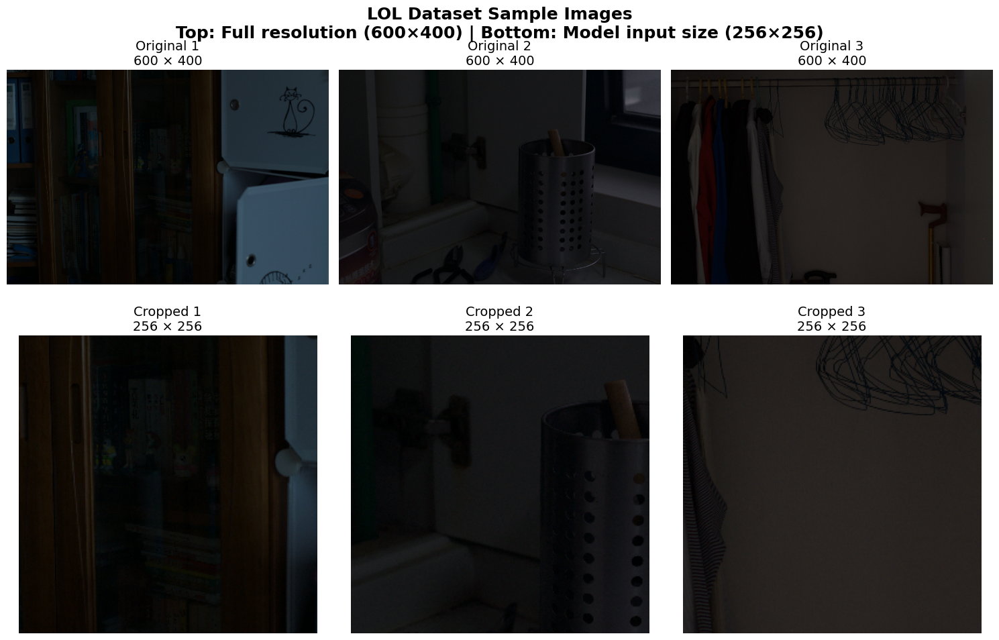

Visualization complete.
→ All training images are processed to 256×256 for faster training.
→ All texting images are reserved as 600×400 for accurate visual observation.


In [6]:
from torchvision.transforms import ToPILImage
import glob

# If you didn't save it as a variable earlier, re-find it quickly
test_low_candidates = glob.glob('**/eval15/low', recursive=True)
if not test_low_candidates:
    raise FileNotFoundError("Test low folder not found. Make sure dataset is loaded properly.")
test_low_dir = test_low_candidates[0]

print(f"Using test low folder: {test_low_dir}")

# Transform used for visualization (same as in test dataset)
test_transform = transforms.Compose([
    transforms.CenterCrop(256),
    transforms.ToTensor(),
])

# Get first 3 test images
test_paths = sorted(glob.glob(os.path.join(test_low_dir, "*.png")))[:3]

if len(test_paths) < 3:
    print(f"Warning: Only found {len(test_paths)} test images. Showing all.")

print("\nShowing sample test images:")
print("Row 1: Original full resolution (600 × 400)")
print("Row 2: After CenterCrop(256) → 256 × 256 input used in model\n")

# Load and process images
original_images = []
resized_images = []

for path in test_paths:
    img_pil = Image.open(path).convert('RGB')
    original_images.append(img_pil)

    # Apply transform
    tensor = test_transform(img_pil)
    resized_pil = ToPILImage()(tensor)  # Convert back to PIL for display
    resized_images.append(resized_pil)

# Plot
fig = plt.figure(figsize=(15, 10))

# Top row: Original
for i in range(len(original_images)):
    ax = fig.add_subplot(2, 3, i + 1)
    ax.imshow(original_images[i])
    ax.set_title(f"Original {i+1}\n600 × 400", fontsize=14)
    ax.axis('off')

# Bottom row: Cropped & resized
for i in range(len(resized_images)):
    ax = fig.add_subplot(2, 3, i + 4)
    ax.imshow(resized_images[i])
    ax.set_title(f"Cropped {i+1}\n256 × 256", fontsize=14)
    ax.axis('off')

plt.subplots_adjust(hspace=0.4)
plt.suptitle("LOL Dataset Sample Images\n"
             "Top: Full resolution (600×400) | Bottom: Model input size (256×256)",
             fontsize=18, fontweight='bold', y=0.95)
plt.tight_layout()
plt.show()

print("Visualization complete.")
print("→ All training images are processed to 256×256 for faster training.")
print("→ All texting images are reserved as 600×400 for accurate visual observation.")

##Cell 6: Model Definition of Zero-DCE++

In [7]:
class DepthWiseConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.depth = nn.Conv2d(in_ch, in_ch, 3, padding=1, groups=in_ch)
        self.point = nn.Conv2d(in_ch, out_ch, 1)
        self.relu  = nn.ReLU(inplace=True)

    def forward(self, x):
        x = self.depth(x)
        x = self.point(x)
        return self.relu(x)

class ZeroDCEPlusPlus(nn.Module):
    def __init__(self, num_iter=8):
        super().__init__()
        self.num_iter = num_iter

        # Encoder (downsampling)
        self.conv1 = DepthWiseConv(3,   32)
        self.conv2 = DepthWiseConv(32,  64)
        self.conv3 = DepthWiseConv(64,  128)
        self.conv4 = DepthWiseConv(128, 256)
        self.conv5 = DepthWiseConv(256, 512)

        self.pool = nn.MaxPool2d(2, 2)  # Explicit downsampling

        # Decoder (upsampling + skip connections)
        self.up5   = nn.ConvTranspose2d(512, 256, 2, stride=2)  # x5 → 256 ch
        self.up4   = nn.ConvTranspose2d(256, 128, 2, stride=2)  # +x4 → 128 ch
        self.up3   = nn.ConvTranspose2d(128, 64,  2, stride=2)  # +x3 → 64 ch

        # Final head
        self.head = nn.Sequential(
            nn.Conv2d(64 + 64, 128, 3, padding=1),   # concat with x2 (64 ch)
            nn.ReLU(inplace=True),
            nn.Conv2d(128, 64, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(64, 3 * num_iter, 3, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        # Encoder
        x1 = self.conv1(x)           # 32
        x2 = self.conv2(x1)          # 64
        p2 = self.pool(x2)

        x3 = self.conv3(p2)          # 128
        p3 = self.pool(x3)

        x4 = self.conv4(p3)          # 256
        p4 = self.pool(x4)

        x5 = self.conv5(p4)          # 512 (bottleneck)

        # Decoder with skip connections
        d5 = self.up5(x5)                    # → 256 ch
        d5 = d5 + x4                         # skip from x4 (256 → 256)

        d4 = self.up4(d5)                    # → 128 ch
        d4 = d4 + x3                         # skip from x3

        d3 = self.up3(d4)                    # → 64 ch
        d3 = d3 + x2                         # skip from x2

        # Final parameter map
        params = self.head(torch.cat([d3, x2], dim=1))  # 64 + 64 = 128
        params = params.view(-1, self.num_iter, 3, x.size(2), x.size(3))
        params = torch.tanh(params) * 5.0   # Stronger range

        # Iterative enhancement
        enhanced = x
        for i in range(self.num_iter):
            A = params[:, i, :, :, :]
            enhanced = enhanced + A * (torch.pow(enhanced, 2) - enhanced)
            enhanced = torch.clamp(enhanced, 0, 1)

        return enhanced, params


# Re-instantiate model
model = ZeroDCEPlusPlus(num_iter=8).to(device)
print(model)
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")


model = ZeroDCEPlusPlus(num_iter=8).to(device)
print(model)
print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")

ZeroDCEPlusPlus(
  (conv1): DepthWiseConv(
    (depth): Conv2d(3, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=3)
    (point): Conv2d(3, 32, kernel_size=(1, 1), stride=(1, 1))
    (relu): ReLU(inplace=True)
  )
  (conv2): DepthWiseConv(
    (depth): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32)
    (point): Conv2d(32, 64, kernel_size=(1, 1), stride=(1, 1))
    (relu): ReLU(inplace=True)
  )
  (conv3): DepthWiseConv(
    (depth): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
    (point): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1))
    (relu): ReLU(inplace=True)
  )
  (conv4): DepthWiseConv(
    (depth): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=128)
    (point): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1))
    (relu): ReLU(inplace=True)
  )
  (conv5): DepthWiseConv(
    (depth): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=256)
    (p

##Cell 7: Loss Functions

In [8]:
def total_loss(enhanced, high, params, low):
    recon_loss = nn.L1Loss()(enhanced, high)

    def spatial_consistency_loss(enhanced, low):
        def gradient(x):
            d_x = x[:, :, :, 1:] - x[:, :, :, :-1]
            d_y = x[:, :, 1:, :] - x[:, :, :-1, :]
            return d_x, d_y

        e_dx, e_dy = gradient(enhanced.mean(1, keepdim=True))
        l_dx, l_dy = gradient(low.mean(1, keepdim=True))

        w_x = torch.exp(-torch.mean(torch.abs(l_dx), 1, keepdim=True))
        w_y = torch.exp(-torch.mean(torch.abs(l_dy), 1, keepdim=True))

        loss_x = torch.mean(w_x * torch.abs(e_dx))
        loss_y = torch.mean(w_y * torch.abs(e_dy))
        return loss_x + loss_y

    def exposure_loss(enhanced, target=0.6):
        enhanced_gray = enhanced.mean(1, keepdim=True)
        return torch.mean((enhanced_gray - target) ** 2)

    def color_loss(enhanced):
        r, g, b = torch.split(enhanced, 1, dim=1)
        mean_r = r.mean([2,3])
        mean_g = g.mean([2,3])
        mean_b = b.mean([2,3])
        return torch.mean((mean_r - mean_g)**2 + (mean_g - mean_b)**2 + (mean_b - mean_r)**2)

    def illumination_smoothness(params):
        loss = 0
        for i in range(params.size(1)):
            A = params[:, i]
            loss += torch.mean(torch.abs(A[:, :, :, :-1] - A[:, :, :, 1:])) + \
                    torch.mean(torch.abs(A[:, :, :-1, :] - A[:, :, 1:, :]))
        return loss / params.size(1)

    s_loss = spatial_consistency_loss(enhanced, low)
    e_loss = exposure_loss(enhanced)
    c_loss = color_loss(enhanced)
    i_loss = illumination_smoothness(params)
    ssim_loss = 1 - ssim_loss_fn(enhanced, high)

    return recon_loss + 10*s_loss + 10*e_loss + 10*c_loss + 0.1*i_loss + 5.0*ssim_loss

##Cell 8: Simple SSIM & PSNR Helper

In [9]:
def calculate_psnr(img1, img2):
    mse = torch.mean((img1 - img2) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * torch.log10(1.0 / torch.sqrt(mse))

def ssim(img1, img2):
    C1 = (0.01)**2
    C2 = (0.03)**2
    mu1 = nn.functional.avg_pool2d(img1, 3, 1, padding=1)
    mu2 = nn.functional.avg_pool2d(img2, 3, 1, padding=1)
    mu1_sq = mu1**2
    mu2_sq = mu2**2
    mu1_mu2 = mu1*mu2
    sigma1_sq = nn.functional.avg_pool2d(img1**2, 3, 1, padding=1) - mu1_sq
    sigma2_sq = nn.functional.avg_pool2d(img2**2, 3, 1, padding=1) - mu2_sq
    sigma12 = nn.functional.avg_pool2d(img1*img2, 3, 1, padding=1) - mu1_mu2

    ssim_map = ((2*mu1_mu2 + C1)*(2*sigma12 + C2)) / ((mu1_sq + mu2_sq + C1)*(sigma1_sq + sigma2_sq + C2))
    return ssim_map.mean()

##Cell 9: Training

###Cell 9.1: Training Loop

In [10]:
from torchmetrics.image import StructuralSimilarityIndexMeasure, PeakSignalNoiseRatio
import numpy as np

# Global metrics
ssim_metric = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)
psnr_metric = PeakSignalNoiseRatio(data_range=1.0).to(device)

# Move ssim_loss_fn here to avoid reference error
ssim_loss_fn = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)

def calculate_psnr(img1, img2):
    return psnr_metric(img1, img2)

# Optimizer & Scheduler
optimizer = optim.AdamW(model.parameters(), lr=2e-4, weight_decay=1e-4)
scheduler = optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=50, T_mult=2, eta_min=1e-6
)

num_epochs = 20
best_psnr = 0.0

# Logging lists - ONLY training loss and validation PSNR/SSIM
train_losses = []
val_psnrs = []
val_ssims = []

for epoch in range(1, num_epochs + 1):
    model.train()
    epoch_loss = 0.0
    progress_bar = tqdm(train_loader, desc=f"Epoch {epoch:3d}/{num_epochs}")

    for low, high in progress_bar:
        low, high = low.to(device), high.to(device)

        optimizer.zero_grad()
        enhanced, params = model(low)
        enhanced = torch.clamp(enhanced, 0, 1)

        loss = total_loss(enhanced, high, params, low)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        epoch_loss += loss.item()
        progress_bar.set_postfix({"Loss": f"{loss.item():.5f}"})

    scheduler.step()
    avg_train_loss = epoch_loss / len(train_loader)
    train_losses.append(avg_train_loss)
    current_lr = optimizer.param_groups[0]['lr']
    print(f"Epoch {epoch:3d} | Train Loss: {avg_train_loss:.4f} | LR: {current_lr:.6f}")

    if epoch % 5 == 0 or epoch == num_epochs:
        model.eval()
        psnr_list = []
        ssim_list = []

        with torch.no_grad():
            for low, high in test_loader:
                low, high = low.to(device), high.to(device)
                enhanced, _ = model(low)
                enhanced = torch.clamp(enhanced, 0, 1)

                psnr_list.append(calculate_psnr(enhanced, high).item())
                ssim_list.append(ssim_metric(enhanced, high).item())

        avg_psnr = np.mean(psnr_list)
        avg_ssim = np.mean(ssim_list)
        val_psnrs.append(avg_psnr)
        val_ssims.append(avg_ssim)

        print(f"Validation → PSNR: {avg_psnr:.2f} dB | SSIM: {avg_ssim:.4f}")

        if avg_psnr > best_psnr:
            best_psnr = avg_psnr
            torch.save(model.state_dict(), 'zero_dce_pp_final.pth')
            print(f"  >>> NEW BEST MODEL SAVED! PSNR: {avg_psnr:.2f} dB")

        if epoch % 20 == 0 or epoch == num_epochs:
            torch.save(model.state_dict(), f'zero_dce_pp_epoch_{epoch}.pth')
            print(f"  >>> Checkpoint saved: zero_dce_pp_epoch_{epoch}.pth")

        print("-" * 70)

print(f"\nTraining completed! Best PSNR: {best_psnr:.2f} dB")
print("Final model and checkpoints saved.")

Epoch   1/20: 100%|██████████| 61/61 [00:20<00:00,  2.98it/s, Loss=6.81612]


Epoch   1 | Train Loss: 6.8490 | LR: 0.000200


Epoch   2/20: 100%|██████████| 61/61 [00:17<00:00,  3.41it/s, Loss=6.14882]


Epoch   2 | Train Loss: 6.7272 | LR: 0.000199


Epoch   3/20: 100%|██████████| 61/61 [00:18<00:00,  3.34it/s, Loss=6.33449]


Epoch   3 | Train Loss: 6.7024 | LR: 0.000198


Epoch   4/20: 100%|██████████| 61/61 [00:19<00:00,  3.17it/s, Loss=6.77959]


Epoch   4 | Train Loss: 6.5915 | LR: 0.000197


Epoch   5/20: 100%|██████████| 61/61 [00:18<00:00,  3.35it/s, Loss=6.01465]

Epoch   5 | Train Loss: 6.5620 | LR: 0.000195


Validation → PSNR: 16.12 dB | SSIM: 0.5553
  >>> NEW BEST MODEL SAVED! PSNR: 16.12 dB
----------------------------------------------------------------------


Epoch   6/20: 100%|██████████| 61/61 [00:18<00:00,  3.31it/s, Loss=6.42128]


Epoch   6 | Train Loss: 6.5273 | LR: 0.000193


Epoch   7/20: 100%|██████████| 61/61 [00:19<00:00,  3.17it/s, Loss=5.30852]


Epoch   7 | Train Loss: 6.5014 | LR: 0.000191


Epoch   8/20: 100%|██████████| 61/61 [00:20<00:00,  2.96it/s, Loss=7.71403]


Epoch   8 | Train Loss: 6.4977 | LR: 0.000188


Epoch   9/20: 100%|██████████| 61/61 [00:18<00:00,  3.26it/s, Loss=6.98590]


Epoch   9 | Train Loss: 6.3930 | LR: 0.000185


Epoch  10/20: 100%|██████████| 61/61 [00:18<00:00,  3.27it/s, Loss=5.66353]

Epoch  10 | Train Loss: 6.3648 | LR: 0.000181


Validation → PSNR: 15.67 dB | SSIM: 0.4826
----------------------------------------------------------------------


Epoch  11/20: 100%|██████████| 61/61 [00:18<00:00,  3.25it/s, Loss=6.49618]


Epoch  11 | Train Loss: 6.3067 | LR: 0.000177


Epoch  12/20: 100%|██████████| 61/61 [00:19<00:00,  3.19it/s, Loss=5.87963]


Epoch  12 | Train Loss: 6.2736 | LR: 0.000173


Epoch  13/20: 100%|██████████| 61/61 [00:18<00:00,  3.31it/s, Loss=6.30582]


Epoch  13 | Train Loss: 6.1533 | LR: 0.000169


Epoch  14/20: 100%|██████████| 61/61 [00:19<00:00,  3.13it/s, Loss=5.56989]


Epoch  14 | Train Loss: 6.1994 | LR: 0.000164


Epoch  15/20: 100%|██████████| 61/61 [00:18<00:00,  3.35it/s, Loss=5.07777]

Epoch  15 | Train Loss: 6.0394 | LR: 0.000159


Validation → PSNR: 15.15 dB | SSIM: 0.4707
----------------------------------------------------------------------


Epoch  16/20: 100%|██████████| 61/61 [00:19<00:00,  3.13it/s, Loss=5.29579]


Epoch  16 | Train Loss: 6.0513 | LR: 0.000154


Epoch  17/20: 100%|██████████| 61/61 [00:18<00:00,  3.38it/s, Loss=4.93864]


Epoch  17 | Train Loss: 5.9417 | LR: 0.000148


Epoch  18/20: 100%|██████████| 61/61 [00:19<00:00,  3.17it/s, Loss=5.81139]


Epoch  18 | Train Loss: 5.9852 | LR: 0.000143


Epoch  19/20: 100%|██████████| 61/61 [00:18<00:00,  3.32it/s, Loss=6.11480]


Epoch  19 | Train Loss: 5.9231 | LR: 0.000137


Epoch  20/20: 100%|██████████| 61/61 [00:18<00:00,  3.34it/s, Loss=5.88012]

Epoch  20 | Train Loss: 5.8693 | LR: 0.000131


Validation → PSNR: 15.50 dB | SSIM: 0.4939
  >>> Checkpoint saved: zero_dce_pp_epoch_20.pth
----------------------------------------------------------------------

Training completed! Best PSNR: 16.12 dB
Final model and checkpoints saved.


###Cell 9.2: Plot Training and Validation Loss Curves

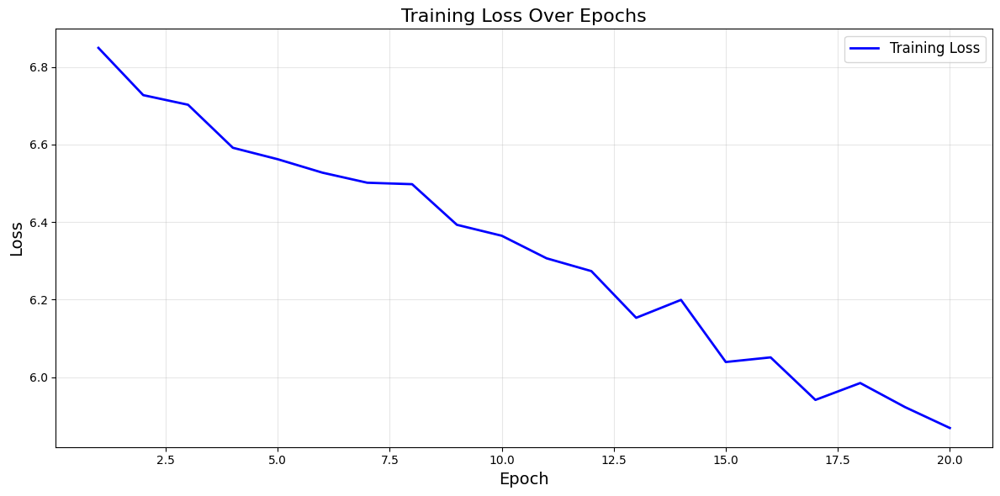

Final Training Loss: 5.8693
Best Validation PSNR: 16.12 dB
Best Validation SSIM: 0.5553


In [11]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
epochs = np.arange(1, len(train_losses) + 1)
plt.plot(epochs, train_losses, label='Training Loss', color='blue', linewidth=2)

plt.title('Training Loss Over Epochs', fontsize=16)
plt.xlabel('Epoch', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(fontsize=12)
plt.tight_layout()
plt.show()

print(f"Final Training Loss: {train_losses[-1]:.4f}")
print(f"Best Validation PSNR: {max(val_psnrs):.2f} dB")
print(f"Best Validation SSIM: {max(val_ssims):.4f}")

##Cell 10: Full-Resolution Inference on Test Images (400×600)

For the model loading, you may either:
  - Uses the provided `zero_dce_pp_trained_default.pth` or;
  - Uses your own `zero_dce_pp_final.pth` trained via Cell 9

###Cell 10.1: Showing one set of Test Image

Selected Test Image Index: 6
Filename: 493.png


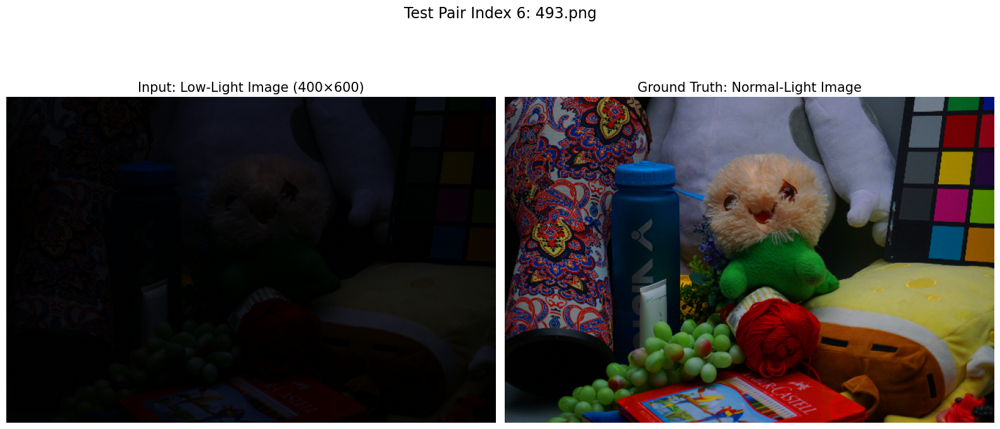

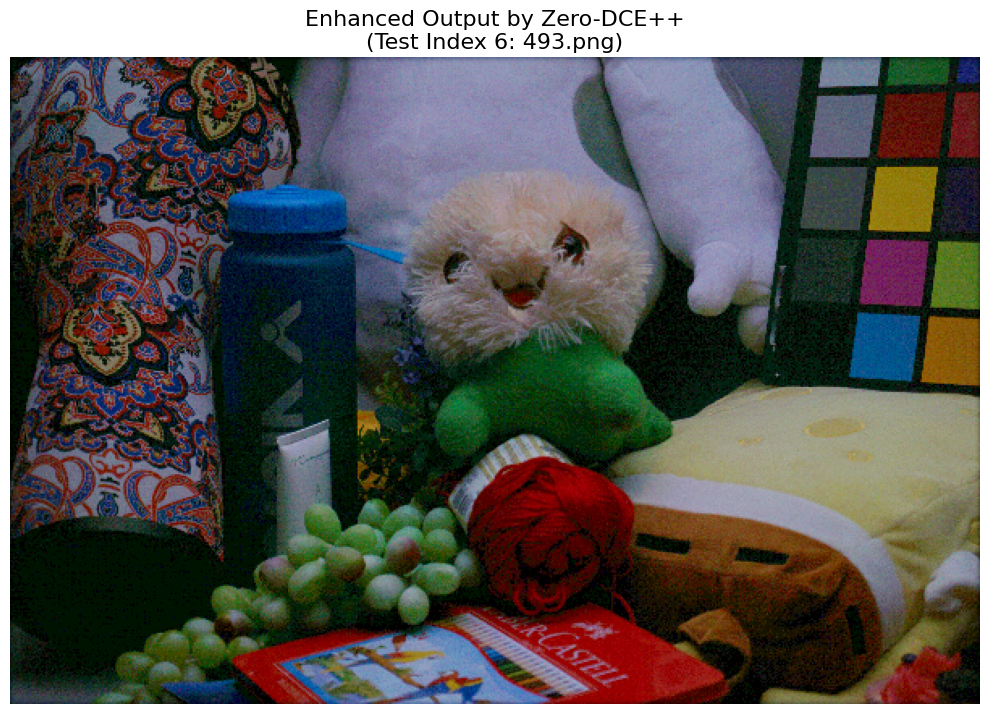

Successfully displayed full-resolution results for index 6.
Model trained on 256x256 patches → but inference done on original 400x600 size.


In [12]:
import matplotlib.pyplot as plt
from torchvision import transforms
from PIL import Image
import os
import glob

# Load the model
if os.path.exists('zero_dce_pp_trained_default.pth'):
    checkpoint_path = 'zero_dce_pp_trained_default.pth'
else:
    checkpoint_path = 'zero_dce_pp_final.pth'

model.load_state_dict(torch.load(checkpoint_path))
model.eval()

# Transform: only to tensor, preserve full 400x600 resolution
full_res_transform = transforms.ToTensor()

# Get all test image paths
test_low_dir = glob.glob('**/eval15/low', recursive=True)[0]
test_high_dir = glob.glob('**/eval15/high', recursive=True)[0]

low_paths = sorted([os.path.join(test_low_dir, f) for f in os.listdir(test_low_dir)])
high_paths = sorted([os.path.join(test_high_dir, f) for f in os.listdir(test_high_dir)])

# =====Change this index to select specific test image (0 to 14) ======
selected_index = 6   # ← CHANGE THIS NUMBER (0-14) to pick your desired test pair
# =====================================================================

if selected_index < 0 or selected_index >= 15:
    raise ValueError("Index must be between 0 and 14 (15 test images)")

low_path = low_paths[selected_index]
high_path = high_paths[selected_index]
filename = os.path.basename(low_path)

print(f"Selected Test Image Index: {selected_index}")
print(f"Filename: {filename}")

# Load images
low_img = Image.open(low_path).convert('RGB')
high_img = Image.open(high_path).convert('RGB')

low_tensor = full_res_transform(low_img).unsqueeze(0).to(device)  # Add batch dim

# Inference
with torch.no_grad():
    enhanced_tensor, _ = model(low_tensor)
    enhanced_tensor = torch.clamp(enhanced_tensor, 0, 1)
    enhanced_img = enhanced_tensor.squeeze(0).cpu()

# Convert to numpy
low_np = low_tensor.squeeze(0).cpu().permute(1, 2, 0).numpy()
high_np = full_res_transform(high_img).permute(1, 2, 0).numpy()
enhanced_np = enhanced_img.permute(1, 2, 0).numpy()

# Graph 1: Low-light vs Ground Truth
plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.imshow(low_np)
plt.title('Input: Low-Light Image (400×600)', fontsize=15)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(high_np)
plt.title('Ground Truth: Normal-Light Image', fontsize=15)
plt.axis('off')

plt.suptitle(f'Test Pair Index {selected_index}: {filename}', fontsize=17)
plt.tight_layout()
plt.show()

# Graph 2: Enhanced Output Only
plt.figure(figsize=(10, 12))
plt.imshow(enhanced_np)
plt.title(f'Enhanced Output by Zero-DCE++\n(Test Index {selected_index}: {filename})', fontsize=16)
plt.axis('off')
plt.tight_layout()
plt.show()

print(f"Successfully displayed full-resolution results for index {selected_index}.")
print("Model trained on 256x256 patches → but inference done on original 400x600 size.")

###Cell 10.2: Showing All Test Images

Running inference on all 15 test images...
Inference complete. Generating grid...


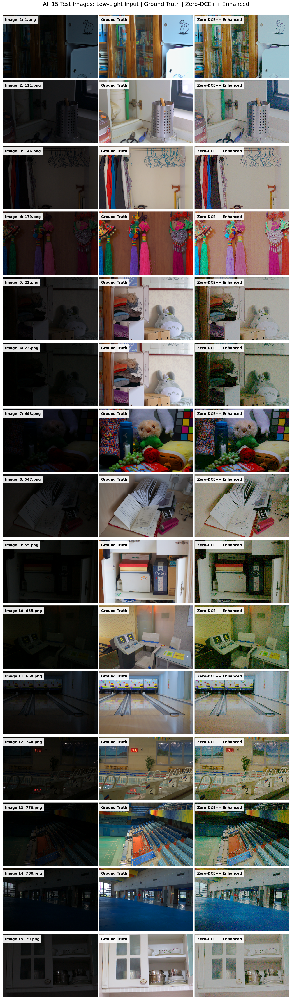

Displayed all 15 full-resolution test results.


In [13]:
import torch
from torchvision.utils import make_grid
import numpy as np


full_res_transform = transforms.ToTensor()

test_low_dir = glob.glob('**/eval15/low', recursive=True)[0]
test_high_dir = glob.glob('**/eval15/high', recursive=True)[0]

low_paths = sorted([os.path.join(test_low_dir, f) for f in os.listdir(test_low_dir)])
high_paths = sorted([os.path.join(test_high_dir, f) for f in os.listdir(test_high_dir)])

num_images = len(low_paths)

low_tensors = []
enhanced_tensors = []
high_tensors = []
filenames = []

print("Running inference on all 15 test images...")

with torch.no_grad():
    for idx in range(num_images):
        low_path = low_paths[idx]
        high_path = high_paths[idx]
        filename = os.path.basename(low_path)
        filenames.append(filename)

        low_img = Image.open(low_path).convert('RGB')
        high_img = Image.open(high_path).convert('RGB')

        low_tensor = full_res_transform(low_img).unsqueeze(0).to(device)

        enhanced_tensor, _ = model(low_tensor)
        enhanced_tensor = torch.clamp(enhanced_tensor, 0, 1)

        low_tensors.append(low_tensor.squeeze(0).cpu())
        enhanced_tensors.append(enhanced_tensor.squeeze(0).cpu())
        high_tensors.append(full_res_transform(high_img))

print("Inference complete. Generating grid...")

# Narrow padding for tight spacing
padding = 8

# Create rows: Low-Light | Ground Truth | Enhanced
row_grids = []
for i in range(num_images):
    row = [low_tensors[i], high_tensors[i], enhanced_tensors[i]]
    row_grid = make_grid(row, nrow=3, padding=padding, pad_value=1.0)
    row_grids.append(row_grid)

row_np_list = [grid.permute(1, 2, 0).numpy() for grid in row_grids]
final_image = np.vstack(row_np_list)

# Display
plt.figure(figsize=(24, 3.8 * num_images))
plt.imshow(final_image)
plt.axis('off')
plt.title('All 15 Test Images: Low-Light Input | Ground Truth | Zero-DCE++ Enhanced',
          fontsize=22, pad=30)

# Calculate positions
image_height_per_row = final_image.shape[0] // num_images
column_width = final_image.shape[1] // 3

# Labels in top-left corner of EACH image
for i in range(num_images):
    # Low-Light column
    plt.text(20, i * image_height_per_row + 30,
             f'Image {i+1:2d}: {filenames[i]}',
             fontsize=14, ha='left', va='top',
             color='black', fontweight='bold',
             bbox=dict(facecolor='white', alpha=0.9, edgecolor='none', pad=8))

    # Ground Truth column
    plt.text(column_width + 20, i * image_height_per_row + 30,
             'Ground Truth',
             fontsize=14, ha='left', va='top',
             color='black', fontweight='bold',
             bbox=dict(facecolor='white', alpha=0.9, edgecolor='none', pad=8))

    # Enhanced column
    plt.text(2 * column_width + 20, i * image_height_per_row + 30,
             'Zero-DCE++ Enhanced',
             fontsize=14, ha='left', va='top',
             color='black', fontweight='bold',
             bbox=dict(facecolor='white', alpha=0.9, edgecolor='none', pad=8))

plt.tight_layout()
plt.subplots_adjust(top=0.97, bottom=0.01, hspace=0.05)
plt.show()

print(f"Displayed all {num_images} full-resolution test results.")

#Creativity Implementation:

##Cell A: Install and Load MobileSAM

In [14]:
!pip install -q git+https://github.com/ChaoningZhang/MobileSAM.git

import torch
from mobile_sam import sam_model_registry, SamAutomaticMaskGenerator
import urllib.request
import os

# Official weights URL (still valid)
checkpoint_url = "https://github.com/ChaoningZhang/MobileSAM/raw/master/weights/mobile_sam.pt"
checkpoint_path = "mobile_sam.pt"

if not os.path.exists(checkpoint_path):
    print("Downloading MobileSAM weights (~20MB)...")
    urllib.request.urlretrieve(checkpoint_url, checkpoint_path)
    print("Download complete!")

# Load model
model_type = "vit_t"
mobile_sam = sam_model_registry[model_type](checkpoint=checkpoint_path)
mobile_sam.to(device)
mobile_sam.eval()

# Optimized mask generator for better quality & central focus
mask_generator = SamAutomaticMaskGenerator(
    model=mobile_sam,
    points_per_side=48,              # More points → better detection of details
    pred_iou_thresh=0.92,            # Stricter → higher quality masks
    stability_score_thresh=0.96,     # More stable masks
    crop_n_layers=1,                 # Light cropping for refinement
    crop_n_points_downscale_factor=2,
    min_mask_region_area=500,        # Ignore tiny noise regions
)

print("MobileSAM loaded & optimized. Ready for precise central object segmentation.")

  Preparing metadata (setup.py) ... done


/usr/local/lib/python3.12/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.12/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.12/dist-packages/mobile_sam/modeling/tiny_vit_sam.py:656: UserWarning: Overwriting tiny_vit_5m_224 in registry with mobile_sam.modeling.tiny_vit_sam.tiny_vit_5m_224. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  return register_model(fn_wrapper)
/usr/local/lib/python3.12/dist-packages/mobile_sam/modeling/tiny_vit_sam.py:656: UserWarning: Overwriting tiny_vit_11m

Download complete!
MobileSAM loaded & optimized. Ready for precise central object segmentation.


##Cell B: Setup & Mask Preview

Found test low directory: lol_dataset/eval15/low
Loaded 15 full-resolution test images (400×600).

Selected Test Image 7/15: 493.png

Running MobileSAM segmentation... (10–25 seconds)

Successfully merged 2 clean doll parts
Ultimate clean whole-doll mask ready – only the little doll, nothing else! 🎯



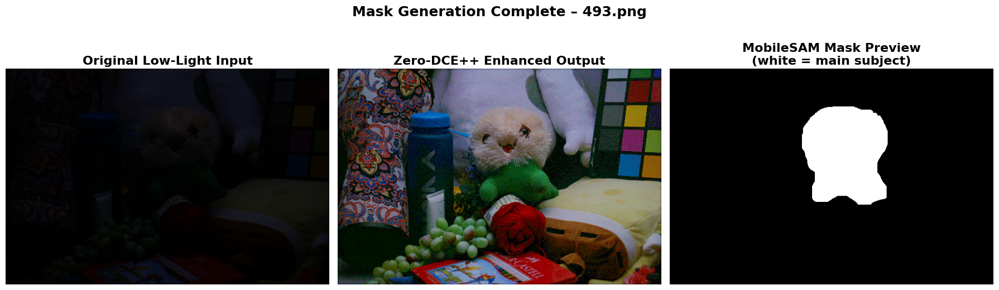

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os
import glob
from torchvision import transforms
import torch

# ==============================
# Auto-detect test low folder
# ==============================
try:
    test_low_dir = glob.glob('**/eval15/low', recursive=True)[0]
except IndexError:
    raise FileNotFoundError(
        "Test low directory not found. Make sure the LOL dataset is downloaded and extracted correctly.\n"
        "Run your dataset loading cell (Cell 3) first to place 'eval15/low' in the project folder."
    )

print(f"Found test low directory: {test_low_dir}")

# Full-resolution transform
full_res_transform = transforms.ToTensor()

# Get all low-light test images
image_extensions = ('.png', '.jpg', '.jpeg')
low_paths = sorted([
    os.path.join(test_low_dir, f)
    for f in os.listdir(test_low_dir)
    if f.lower().endswith(image_extensions)
])

print(f"Loaded {len(low_paths)} full-resolution test images (400×600).")

# =====Change this index to select specific test image (0 to 14) ======
selected_index = 6   # ← CHANGE THIS NUMBER (0-14) to pick your desired test pair
# =====================================================================

if selected_index < 0 or selected_index >= len(low_paths):
    raise ValueError(f"Invalid index {selected_index}. Must be between 0 and {len(low_paths)-1}.")

low_path = low_paths[selected_index]
filename = os.path.basename(low_path)

print(f"\nSelected Test Image {selected_index + 1}/{len(low_paths)}: {filename}")

# Load and enhance
low_img_pil = Image.open(low_path).convert('RGB')
low_tensor = full_res_transform(low_img_pil).unsqueeze(0).to(device)

# Load the model
if os.path.exists('zero_dce_pp_trained_default.pth'):
    checkpoint_path = 'zero_dce_pp_trained_default.pth'
else:
    checkpoint_path = 'zero_dce_pp_final.pth'

model.load_state_dict(torch.load(checkpoint_path))
model.eval()

with torch.no_grad():
    enhanced_tensor, _ = model(low_tensor)
    enhanced_tensor = torch.clamp(enhanced_tensor, 0, 1)

enhanced_np = enhanced_tensor[0].cpu().permute(1, 2, 0).numpy()
low_np = low_tensor[0].cpu().permute(1, 2, 0).numpy()
image_for_sam = (enhanced_np * 255).astype(np.uint8)

# Run MobileSAM
print("\nRunning MobileSAM segmentation... (10–25 seconds)\n")
masks = mask_generator.generate(image_for_sam)

H, W = image_for_sam.shape[:2]
center_x, center_y = W // 2, H // 2

# Slightly smaller central region to focus tightly on the doll itself (avoiding bottom object)
half_w = int(W * 0.16)
half_h = int(H * 0.16)
central_region = np.zeros((H, W), dtype=np.uint8)
central_region[center_y - half_h : center_y + half_h,
               center_x - half_w : center_x + half_w] = 1

if len(masks) == 0:
    subject_mask = central_region.astype(np.uint8)
else:
    def doll_score(m_dict):
        m = m_dict['segmentation']
        overlap_ratio = np.sum(m & central_region) / (np.sum(m) + 1e-6)
        area_ratio = m_dict['area'] / (H * W)
        # Very strong reward for center overlap, heavy penalty for large area (bottle & bottom object)
        return overlap_ratio * 20.0 - area_ratio * 8.0

    masks.sort(key=doll_score, reverse=True)

    # Only select masks with extremely high center overlap and small-to-medium size
    selected_masks = []
    for m_dict in masks[:30]:
        score = doll_score(m_dict)
        area_ratio = m_dict['area'] / (H * W)
        if score > 4.0 and 0.015 < area_ratio < 0.08:  # strict size: 1.5% ~ 8%
            selected_masks.append(m_dict['segmentation'])

    if not selected_masks:
        print("No perfect match → using the single highest-scoring mask")
        subject_mask = masks[0]['segmentation'].astype(np.uint8)
    else:
        subject_mask = np.logical_or.reduce(selected_masks).astype(np.uint8)
        print(f"Successfully merged {len(selected_masks)} clean doll parts")

    # Connect head and body with moderate closing
    kernel_close = np.ones((11, 11), np.uint8)
    subject_mask = cv2.morphologyEx(subject_mask, cv2.MORPH_CLOSE, kernel_close, iterations=2)

    # Aggressive opening to remove any remaining small noise, shadow, or bottom object fragments
    kernel_open = np.ones((11, 11), np.uint8)
    subject_mask = cv2.morphologyEx(subject_mask, cv2.MORPH_OPEN, kernel_open, iterations=2)

    # No dilation or very minimal — keep mask tight
    kernel_tiny = np.ones((3, 3), np.uint8)
    subject_mask = cv2.dilate(subject_mask, kernel_tiny, iterations=1)

print("Ultimate clean whole-doll mask ready – only the little doll, nothing else! 🎯\n")

# === Original 3-panel graph layout (exactly unchanged as requested) ===
plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plt.imshow(low_np)
plt.title("Original Low-Light Input", fontsize=16, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(enhanced_np)
plt.title("Zero-DCE++ Enhanced Output", fontsize=16, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(subject_mask, cmap='gray')
plt.title("MobileSAM Mask Preview\n(white = main subject)", fontsize=16, fontweight='bold')
plt.axis('off')

plt.suptitle(f"Mask Generation Complete – {filename}", fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

##Cell C: Creative Effect 1 – Spotlight (using mask from Cell B)

Applying Spotlight Effect (main subject highlighted, background darkened)...



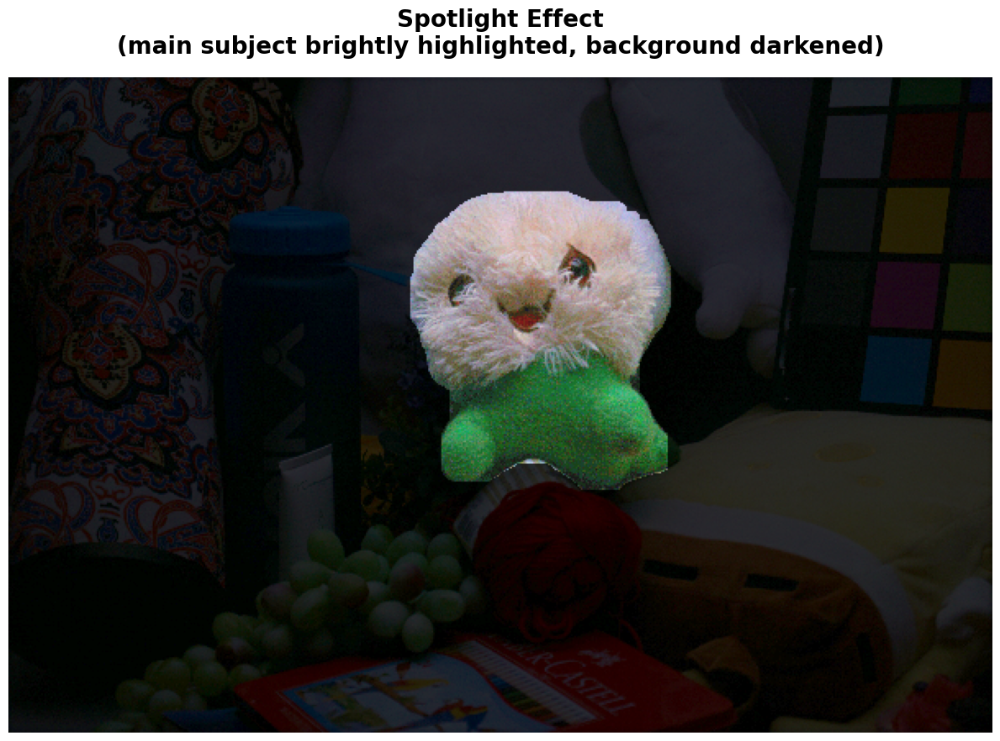

Spotlight Effect complete.


In [16]:
if 'subject_mask' not in globals() or 'enhanced_np' not in globals():
    raise NameError("Please run Cell B first to generate the mask.")

print("Applying Spotlight Effect (main subject highlighted, background darkened)...\n")

# Create spotlight result
spotlight_result = enhanced_np.copy()

# Darken background significantly
spotlight_result[subject_mask == 0] *= 0.25

# Slightly brighten and boost contrast on the doll
spotlight_result[subject_mask == 1] = np.clip(spotlight_result[subject_mask == 1] * 1.15 + 0.1, 0, 1)

# Large final display only
plt.figure(figsize=(12, 10))
plt.imshow(spotlight_result)
plt.title("Spotlight Effect\n(main subject brightly highlighted, background darkened)",
          fontsize=20, fontweight='bold', pad=20)
plt.axis('off')
plt.tight_layout()
plt.show()

print("Spotlight Effect complete.")

##Cell D: Creative Effect 2 –Blurry Background / Bokeh Effect (using mask from Cell B)

Applying Blurry Background (Bokeh) Effect...



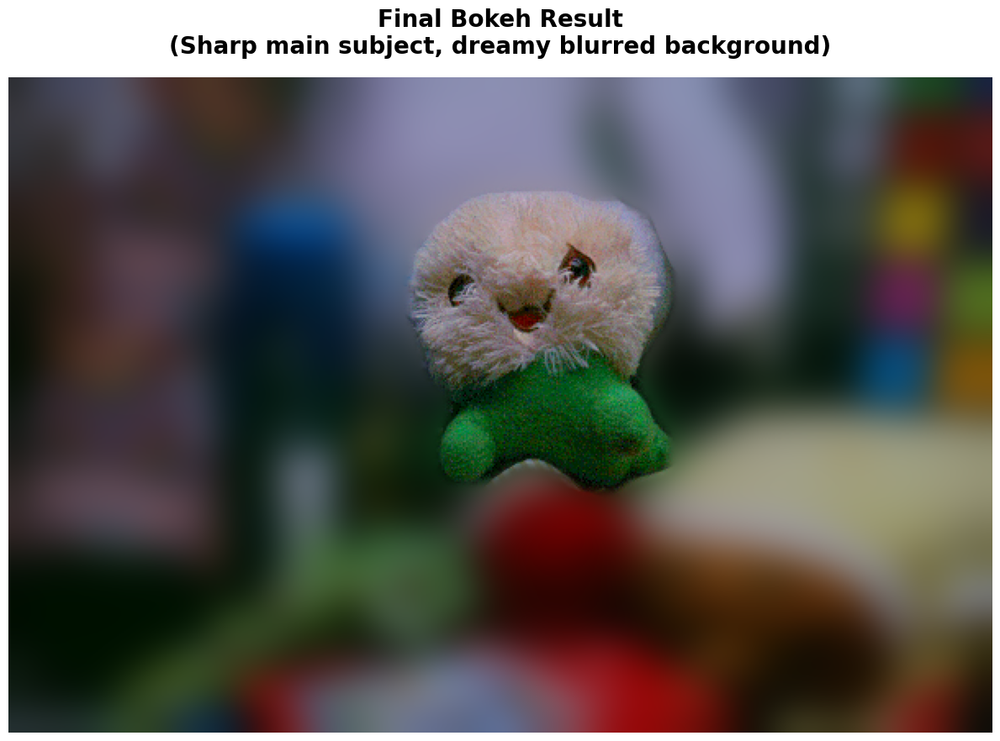

Blurry Background (Bokeh) Effect complete.


In [17]:
if 'subject_mask' not in globals() or 'enhanced_np' not in globals():
    raise NameError("Please run Cell B first to generate the mask!")

print("Applying Blurry Background (Bokeh) Effect...\n")

# Create soft edge mask
bokeh_mask = subject_mask.copy().astype(np.float32)
kernel = np.ones((15, 15), np.uint8)
bokeh_mask = cv2.GaussianBlur(bokeh_mask, (15, 15), 0)

# Strong background blur
blur_strength = 81
blurred_bg = cv2.GaussianBlur(enhanced_np, (blur_strength, blur_strength), 0)

# Composite: sharp doll + dreamy blurred background
bokeh_result = enhanced_np * np.stack([bokeh_mask] * 3, axis=2) + \
               blurred_bg * (1 - np.stack([bokeh_mask] * 3, axis=2))

# Slightly enhance doll for pop
bokeh_result[subject_mask == 1] = np.clip(bokeh_result[subject_mask == 1] * 1.08, 0, 1)

# Large final display only
plt.figure(figsize=(12, 10))
plt.imshow(bokeh_result)
plt.title("Final Bokeh Result\n(Sharp main subject, dreamy blurred background)",
          fontsize=20, fontweight='bold', pad=20)
plt.axis('off')
plt.tight_layout()
plt.show()

print("Blurry Background (Bokeh) Effect complete.")